## **Actividad VIII - Proyecto final**

**Objetivo general**

Utilizar modelos de Machine Learning para resolver un problema de una industria o negocio.

**Objetivos específicos**

1. Retomar el trabajo realizado en la segunda pre entrega, sumando el trabajo con Machine Learning.
2. Modelar la situación como un problema de Machine Learning.
3. Entrenar modelos de Machine Learning.
4. Realizar ingeniería de atributos y normalización/estandarización de variables.
5. Seleccionar el modelo con mejor performance.

**Requisitos base**

1. Abstracto con motivación y audiencia: Descripción de alto nivel de lo que motiva a analizar los datos elegidos y audiencia que se podría beneficiar de este análisis.
2. Preguntas/Problema que buscamos resolver: Si bien puede haber más de una problemática a resolver, la problemática principal debe encuadrarse como un problema de clasificación o regresión.
3. Breve Análisis Exploratorio de Datos (EDA): Análisis descriptivo de los datos mediante visualizaciones y herramientas estadísticas, análisis de valores faltantes.
4. Ingeniería de atributos: Creación de nuevas variables, transformación de variables existentes (i.e normalización de variables, encoding, etc.).
5. Entrenamiento y Testeo: Entrenamiento y testeo de al menos 2 modelos distintos de Machine Learning utilizando algún método de validación cruzada.
6. Optimización: Utilizar alguna técnica de optimización de hiperparámetros(e.g gridsearch, randomizedsearch, etc.).
7. Selección de modelos: utilizar las métricas apropiadas para la selección del mejor modelo (e.g AUC, MSE, etc.)

## **Desarrollo**

**Importamos las librerías que más se utilizarán durante el análisis y desarrollo del proyecto**

In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt 
import plotly.express as px
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode,plot,plot, iplot
init_notebook_mode(connected=True)

from sqlalchemy import create_engine
import psycopg2

import warnings
warnings.filterwarnings("ignore") 

**1. Abstracto con motivación y audiencia:**

Me interesa conocer el comportamiento de ventas de vehículos eléctricos durante los últimos años y encontrar los vehículos que cuentan con mejor autonomía por carga de su batería. 

En éste caso se analizan datos de vehículos eléctricos registrados en el Estado de Washington en Estados Unidos.

Este Dataset muestra los Vehículos de Batería Eléctrica (BEVs) y Vehículos Eléctricos Híbridos (PHEVs), registrados actualmente en el Departamento de Licencias del Estado de Washington (DOL). Metadata Actualizada: March 16, 2024 URL: https://catalog.data.gov/dataset/electric-vehicle-population-data

**Cargamos el Dataset, mediante la librería pandas**

In [2]:
Dataset = pd.read_csv("https://raw.githubusercontent.com/Fab-RG/Bootcamp-DS/main/Actividad%202/Electric_Vehicle_Population_Data.csv", sep=",")
Dataset

,VIN (1-10),County,City,State,Postal Code,Model Year,Make,Model,Electric Vehicle Type,Clean Alternative Fuel Vehicle (CAFV) Eligibility,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,Vehicle Location,Electric Utility,2020 Census Tract
0,5YJYGDEE1L,King,Seattle,WA,98122.0,2020,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,291,0,37.0,125701579,POINT (-122.30839 47.610365),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),5.303301e+10
1,7SAYGDEE9P,Snohomish,Bothell,WA,98021.0,2023,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,1.0,244285107,POINT (-122.179458 47.802589),PUGET SOUND ENERGY INC,5.306105e+10
2,5YJSA1E4XK,King,Seattle,WA,98109.0,2019,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,270,0,36.0,156773144,POINT (-122.34848 47.632405),CITY OF SEATTLE - (WA)|CITY OF TACOMA - (WA),5.303301e+10
3,5YJSA1E27G,King,Issaquah,WA,98027.0,2016,TESLA,MODEL S,Battery Electric Vehicle (BEV),Clean Alternative Fuel Vehicle Eligible,210,0,5.0,165103011,POINT (-122.03646 47.534065),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),5.303303e+10
4,5YJYGDEE5M,Kitsap,Suquamish,WA,98392.0,2021,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,23.0,205138552,POINT (-122.55717 47.733415),PUGET SOUND ENERGY INC,5.303594e+10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
177861,7SAYGDEE3N,Pierce,Bonney Lake,WA,98391.0,2022,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,31.0,195224452,POINT (-122.183805 47.18062),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),5.305307e+10
177862,KM8K23AG1P,Mason,Shelton,WA,98584.0,2023,HYUNDAI,KONA ELECTRIC,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,35.0,228454180,POINT (-123.105305 47.211085),BONNEVILLE POWER ADMINISTRATION||CITY OF TACOM...,5.304596e+10
177863,5YJYGDEE6M,Grant,Quincy,WA,98848.0,2021,TESLA,MODEL Y,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,13.0,168797219,POINT (-119.8493873 47.2339933),PUD NO 2 OF GRANT COUNTY,5.302501e+10
177864,WVGKMPE27M,King,Black Diamond,WA,98010.0,2021,VOLKSWAGEN,ID.4,Battery Electric Vehicle (BEV),Eligibility unknown as battery range has not b...,0,0,5.0,182448801,POINT (-122.00451 47.312185),PUGET SOUND ENERGY INC||CITY OF TACOMA - (WA),5.303303e+10


**2. Preguntas problema que buscamos resolver:**

- ¿Se evidencia incremento de registro de vehículos eléctricos durante los últimos cuatro años?
- ¿En qué año se registró la mayor cantidad de vehículos eléctricos?
- ¿Cuál es la marca de vehículos eléctricos que más se registró en los últimos cuatro años?
- ¿Cuál es la ciudad donde se registraron la mayor cantidad de vehículos eléctricos?
- ¿Diferencia entre la cantidad de vehículos de batería eléctrica (BEV) y los Vehículos Eléctricos Híbridos (PHEVs)?
- ¿Cuál es el modelo de vehículo con mayor autonomía de utilización de su batería?

**3. Breve Análisis Exploratorio de Datos (EDA):**

Se observa la información resumida de Dataset, incluida la cantidad de filas (177866), columnas y su nombre (17), el tipo de dato (object, float64 e int64) y cantidad de datos nulos por columna (No se tienen datos nulos). 

In [3]:
Dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 177866 entries, 0 to 177865
Data columns (total 17 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   VIN (1-10)                                         177866 non-null  object 
 1   County                                             177861 non-null  object 
 2   City                                               177861 non-null  object 
 3   State                                              177866 non-null  object 
 4   Postal Code                                        177861 non-null  float64
 5   Model Year                                         177866 non-null  int64  
 6   Make                                               177866 non-null  object 
 7   Model                                              177866 non-null  object 
 8   Electric Vehicle Type                              177866 non-null  object

Se consulta resumen estadístico de las variables con tipos de datos flotantes y enteros.

In [4]:
Dataset.describe()

,Postal Code,Model Year,Electric Range,Base MSRP,Legislative District,DOL Vehicle ID,2020 Census Tract
count,177861.000000,177866.000000,177866.000000,177866.000000,177477.000000,1.778660e+05,1.778610e+05
mean,98172.453506,2020.515512,58.842162,1073.109363,29.127481,2.202313e+08,5.297672e+10
std,2442.450668,2.989384,91.981298,8358.624956,14.892169,7.584987e+07,1.578047e+09
min,1545.000000,1997.000000,0.000000,0.000000,1.000000,4.385000e+03,1.001020e+09
25%,98052.000000,2019.000000,0.000000,0.000000,18.000000,1.814743e+08,5.303301e+10
50%,98122.000000,2022.000000,0.000000,0.000000,33.000000,2.282522e+08,5.303303e+10
75%,98370.000000,2023.000000,75.000000,0.000000,42.000000,2.548445e+08,5.305307e+10
max,99577.000000,2024.000000,337.000000,845000.000000,49.000000,4.792548e+08,5.603300e+10


A continuación, se realiza análisis con cálculos y visualizaciones para responder las preguntas problema planteadas anteriormente.

**- ¿Se evidencia incremento de registro de vehículos eléctricos durante los últimos cuatro años?**

**- ¿En qué año se registró la mayor cantidad de vehículos eléctricos?**

In [5]:
cantidad = Dataset['Model Year'].value_counts()
cantidad = pd.DataFrame(cantidad).reset_index()
cantidad.rename(columns={'Model Year': 'Año', 'count': 'Cantidad'}, inplace=True)
cantidad.head(10)

,Año,Cantidad
0,2023,57587
1,2022,27776
2,2021,19132
3,2018,14323
4,2020,11768
5,2019,10940
6,2017,8562
7,2024,7080
8,2016,5483
9,2015,4844


Text(0.5, 1.0, 'Cantidad de Vehículos Registrados por Año')

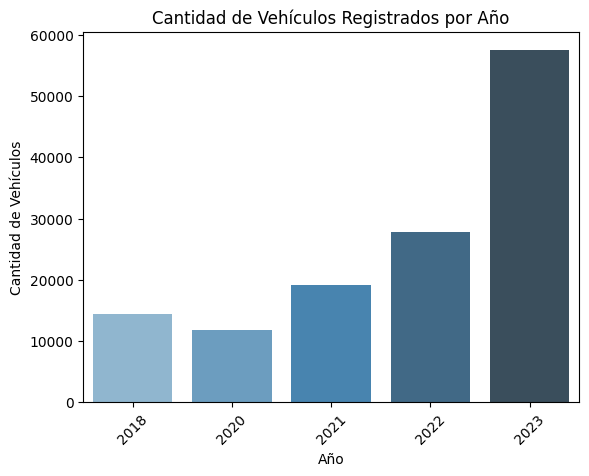

In [6]:
x = Dataset['Model Year'].value_counts().head().index
y = Dataset['Model Year'].value_counts().head().values 
sns.barplot(x=x, y=y, palette="Blues_d")
plt.xticks(rotation=45)
plt.xlabel('Año')
plt.ylabel('Cantidad de Vehículos')
plt.title('Cantidad de Vehículos Registrados por Año')

**Respuesta**: Se evidencia que durante los últimos cuatro años, aumentó el registro de vehículos eléctricos cada año, respecto al anterior. En el año 2023 se evidenció la mayor cantidad de vehículos eléctricos registrados, aumentando más del doble la cantidad registrada el año anterior.

**Recomendación**: Para obtener la respuesta a la pregunta rápidamente, se recomienda tener en cuenta los datos de los últimos cinco años especialmente, debido a que fueron los años donde más se registraron vehículos eléctricos en el Estado de Washington en Estados Unidos.

**- ¿Cuál es la marca de vehículos eléctricos que más se registró en los últimos cuatro años?**

In [7]:
gr2 = Dataset[['Make','Model Year']].value_counts()[0:10]
gr2 = pd.DataFrame(gr2).reset_index()
gr2.rename(columns={'Make': 'Marca', 'Model Year': 'Año', 'count': 'Cantidad'}, inplace=True)
gr2

,Marca,Año,Cantidad
0,TESLA,2023,28650
1,TESLA,2022,13751
2,TESLA,2021,11118
3,TESLA,2018,7915
4,TESLA,2020,7094
5,TESLA,2019,4725
6,FORD,2023,3010
7,CHEVROLET,2023,2872
8,RIVIAN,2023,2833
9,CHEVROLET,2017,2827


Text(0, 0.5, 'Marca')

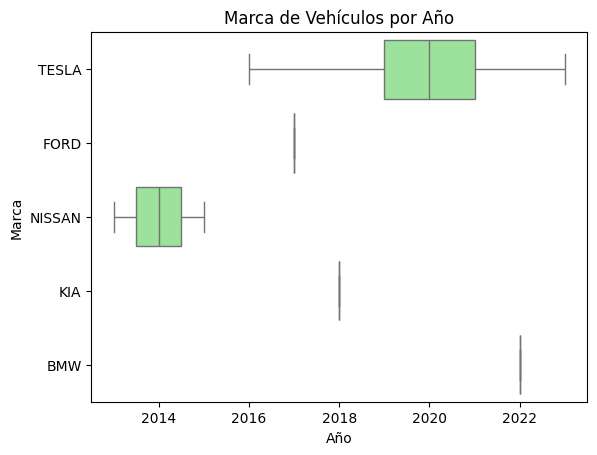

In [8]:
gr2 = Dataset[['Model Year','Make']][0:10]
sns.boxplot(data=gr2, x = 'Model Year', y ='Make', showfliers= True, color='LightGreen')
plt.title('Marca de Vehículos por Año')
plt.xlabel('Año')
plt.ylabel('Marca')

**Respuesta:** Se evidencia que Tesla fue la marca de vehículos eléctricos que más se registró en los últimos cuatro años. 

**Recomendación**: Tener en cuenta que en el cálculo matemático, se evidencia el valor máximo de cantidad de vehículos y el año que sucedió por cada marca. 

**- ¿Cuál es la ciudad donde se registraron la mayor cantidad de vehículos eléctricos?**

In [9]:
ciudades = Dataset['City'].value_counts().head(20)
ciudades = pd.DataFrame(ciudades).reset_index()
ciudades.rename(columns={'City': 'Ciudad', 'count': 'Cantidad'}, inplace=True)
ciudades[:10]

,Ciudad,Cantidad
0,Seattle,29447
1,Bellevue,8931
2,Redmond,6478
3,Vancouver,6193
4,Bothell,5863
5,Kirkland,5362
6,Sammamish,5280
7,Renton,4980
8,Olympia,4299
9,Tacoma,3722


In [10]:
x = Dataset['City'].value_counts().head(10).index
y = Dataset['City'].value_counts().head(10).values
fig = px.histogram(Dataset, x, y, color=x, text_auto=True)
fig.update_layout(
    title='Top 10 de ciudades del Estado de Washington Estados Unidos con más Vehículos Eléctricos',
    xaxis_title='Ciudad',
    yaxis_title='Cantidad de Vehículos Registrados',
    legend_title='Ciudad',
    plot_bgcolor='white',
    bargap=0.05)

**Respuesta:** Se evidencia que la ciudad de Seattle, es donde se ha registrado la mayor cantidad de vehículos eléctricos del Estado de Washington, Estados Unidos.

**Recomendación:** Llama la atención que la cantidad de vehículos registrados por ciudad, no es directamente proporcional a la cantidad de habitantes de cada una de ellas. Por ejemplo, Redmond, Bothell, Kirkland, Sammamish y Olympia, tienen menor población que una amplia cantidad de ciudades.

**- ¿Cuál es la diferencia entre la cantidad de vehículos de batería eléctrica (BEV) y los Vehículos Eléctricos Híbridos (PHEVs)?**

In [11]:
info = Dataset['Electric Vehicle Type'].value_counts()
Df = pd.DataFrame(info).reset_index()
Df.rename(columns={'Electric Vehicle Type': 'Tipo de Vehículo Eléctrico', 'count': 'Cantidad'}, inplace=True)
Df

,Tipo de Vehículo Eléctrico,Cantidad
0,Battery Electric Vehicle (BEV),139210
1,Plug-in Hybrid Electric Vehicle (PHEV),38656


*Calculamos la diferencia que hay entre los dos tipos de vehículos*

In [12]:
info.diff(-1)

Electric Vehicle Type
Battery Electric Vehicle (BEV)            100554.0
Plug-in Hybrid Electric Vehicle (PHEV)         NaN
Name: count, dtype: float64

In [13]:
fig = go.Figure(px.pie(Dataset, names='Electric Vehicle Type', title='Distribución de Tipos de Vehículos Eléctricos', color='Electric Vehicle Type'))
            
fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                  textinfo= 'label+percent+value', pull=[0.2, 0,0],
                  marker=dict(line=dict(color='#FFFFFF',width=2)))

**Respuesta:** Se evidencia que los vehículos que tienen solo Batería Eléctrica, triplican la cantidad de vehículos Híbridos, teniendo 100554 vehículos de diferencia.

**Recomendación:** Para éste caso, todos los datos se tuvieron en cuenta para el cálculo. Además, se aclara que los vehículos híbridos también son considerados como vehículos eléctricos.

**- ¿Cuál es el vehículo con mayor autonomía de utilización de su batería?**

In [14]:
autonomia = Dataset[['Make', 'Model','Electric Range']].drop_duplicates('Electric Range').sort_values('Electric Range', ascending=False).head(30)
autonomia = pd.DataFrame(autonomia).reset_index().drop(['index'], axis=1)
autonomia.rename(columns={'Make': 'Marca', 'Model': 'Modelo', 'Electric Range': 'Autonomía en millas'}, inplace=True)
autonomia

,Marca,Modelo,Autonomía en millas
0,TESLA,MODEL S,337
1,TESLA,MODEL S,330
2,TESLA,MODEL 3,322
3,TESLA,MODEL 3,308
4,TESLA,MODEL X,293
5,TESLA,MODEL Y,291
6,TESLA,MODEL X,289
7,TESLA,MODEL S,270
8,TESLA,MODEL 3,266
9,TESLA,MODEL S,265


In [15]:
fig = px.scatter(data_frame=autonomia, x='Marca', y='Autonomía en millas', color='Modelo', size='Autonomía en millas', title='Vehículos Eléctricos con mejor Autonomía de Batería')
fig.update_layout(uniformtext_minsize=6)
fig.update_layout(xaxis_tickangle= -45)   

**Respuesta:** En general, la marca Tesla tiene los vehículos eléctricos con mayor autonomía por millas, entre los cuales se evidencia el modelo S con 337 millas como el vehículo con mayor autonomía.

**Recomendación:** Tener en cuenta que la unidad de medida en el eje y, es la cantidad de millas que tiene cada vehículo de autonomía por cada carga de su batería.

**4. Ingeniería de atributos:**

**6. Optimización:**

Como se indicó anteriormente, el Dataset empleado para éste análisis no tiene datos nulos.

Se aplica método UMAP, para segmentar los vehículos eléctricos con base en la autonomía de sus baterías.

Se ajusta Dataset original con las variables que tendré en cuenta para normalizar y optimizar las variables que deseo analizar.

In [16]:
newdataset = Dataset[['Make', 'Model', 'Model Year', 'Postal Code', 'DOL Vehicle ID', 'Electric Range']].drop_duplicates('Electric Range').sort_values('Electric Range', ascending=False).reset_index().drop('index', axis=1)
newdataset['Make_Model'] = newdataset.Make.str.cat(newdataset.Model, sep=' ')
newdataset = newdataset.drop(['Make','Model'], axis=1).set_index('Make_Model')
newdataset

,Model Year,Postal Code,DOL Vehicle ID,Electric Range
Make_Model,,,,
TESLA MODEL S,2020,98512.0,109807414,337
TESLA MODEL S,2020,98006.0,8740938,330
TESLA MODEL 3,2020,98126.0,121690915,322
TESLA MODEL 3,2020,98101.0,144264130,308
TESLA MODEL X,2020,98104.0,8099885,293
...,...,...,...,...
MERCEDES-BENZ GLC-CLASS,2019,98188.0,144653862,10
MERCEDES-BENZ GLC-CLASS,2018,98133.0,180723182,9
MERCEDES-BENZ GLE-CLASS,2018,98110.0,475967012,8


Aplico método StandardScaler para transformar los datos a una matriz

In [17]:
from sklearn.preprocessing import StandardScaler

valores = newdataset.values
escalar = StandardScaler() 
valores_new = escalar.fit_transform(valores)
valores_new.shape

(102, 4)

Se implementa método UMAP para reducir las variables.

In [18]:
import umap

reducir = umap.UMAP(n_neighbors=15, n_components=2, metric='minkowski')

Se entrena algoritmo con la información reducida en paso anterior.

In [19]:
entrenar = reducir.fit_transform(valores_new)

Se convierte información entrenada sobre algoritmo, en un Dataframe y se asignan los nombres a las columnas de la tabla.

In [20]:
final = pd.DataFrame(entrenar,columns=['Comp_1','Comp_2'])
final['Make_Model'] = newdataset.index
final

,Comp_1,Comp_2,Make_Model
0,3.262328,6.000375,TESLA MODEL S
1,2.618577,5.986393,TESLA MODEL S
2,2.749609,6.338598,TESLA MODEL 3
3,2.940949,6.302079,TESLA MODEL 3
4,2.546325,6.036179,TESLA MODEL X
...,...,...,...
97,8.439398,4.222271,MERCEDES-BENZ GLC-CLASS
98,8.381063,3.855017,MERCEDES-BENZ GLC-CLASS
99,4.916770,2.462354,MERCEDES-BENZ GLE-CLASS
100,6.407917,2.651343,TOYOTA PRIUS PLUG-IN


Se grafican componentes agrupados y se indica la marca con el modelo correspondiente de cada vehículo eléctrico.

Text(0, 0.5, 'Comp_2')

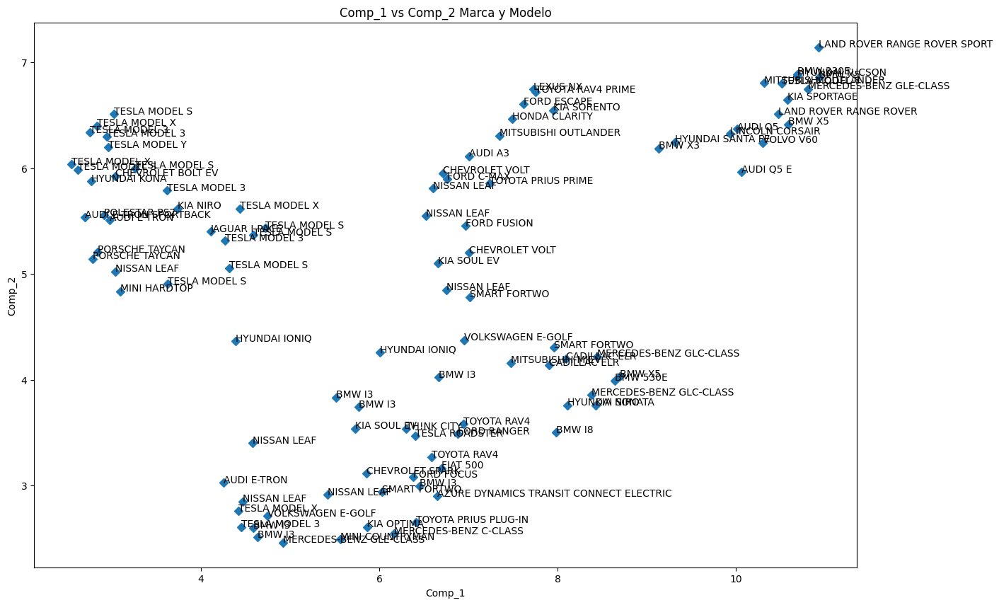

In [21]:
from matplotlib import pyplot as plt
plt.figure(figsize=(15,10))

ax = final.set_index('Comp_1')['Comp_2'].plot(style='D')
def label_point(x, y, val, ax):
  a = pd.concat({'x': x, 'y': y, 'Make_Model': val}, axis=1)
  for i, point in a.iterrows():
    ax.text(point['x'], point['y'], str(point['Make_Model']))

label_point(final.Comp_1, final.Comp_2, final.Make_Model, ax)
plt.title('Comp_1 vs Comp_2 Marca y Modelo')
plt.xlabel('Comp_1',color='Black')
plt.ylabel('Comp_2',color='black')

**Conclusiones.**

- Se observan los vehículos con mayor autonomía de millas por carga de batería, en la parte superior izquierda de la gráfica, entre los cuales se encuentra el Tesla Modelo S, Tesla Modelo 3, Porshe Taycan, etc.

- Además, se observan los vehículos con menor autonomía por carga de batería, en la parte superior derecha de la gráfica, entre los cuales se encuentra el Mercedes-Benz GLE-CLASS, Tesla Modelo Y, BMW X5, Audi Q5 E, Eetc.

**5. Entrenamiento y Testeo:**

In [22]:
from pandas import read_csv
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error

Se ajustan valores para evualuar con modelo de Regresión Lineal.

In [23]:
valores = pd.DataFrame(final,columns=['Comp_1','Comp_2'])
valores = valores.values
valores

array([[ 3.262328 ,  6.0003753],
       [ 2.6185772,  5.9863935],
       [ 2.7496088,  6.338598 ],
       [ 2.9409494,  6.3020787],
       [ 2.5463254,  6.036179 ],
       [ 2.9593463,  6.199256 ],
       [ 2.8354306,  6.4008784],
       [ 3.0243804,  6.51245  ],
       [ 3.6149669,  5.787978 ],
       [ 4.5881314,  5.368312 ],
       [ 3.0412762,  5.9261436],
       [ 2.76847  ,  5.878802 ],
       [ 4.3155317,  5.0579505],
       [ 6.399773 ,  3.4708383],
       [ 3.7330294,  5.6201906],
       [ 4.421823 ,  2.7587929],
       [ 4.109702 ,  5.402492 ],
       [ 2.9129903,  5.5541925],
       [ 2.9746966,  5.507977 ],
       [ 4.265683 ,  5.315294 ],
       [ 2.6984065,  5.535576 ],
       [ 4.452221 ,  2.6106298],
       [ 3.6254144,  4.907303 ],
       [ 4.7227635,  5.4367757],
       [ 4.2549467,  3.029653 ],
       [ 2.7806046,  5.1443133],
       [ 4.433973 ,  5.6203275],
       [ 2.8392508,  5.2069125],
       [ 4.388525 ,  4.368635 ],
       [ 4.5878873,  2.5990248],
       [ 4

Separamos los datos de variables X - y, para entrenar modelo y realizar pruebas.

In [24]:
X, y = valores[:, :-1], valores[:, -1]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

Se aplica modelo de Regresión Lineal y se calcula el error medio absoluto

In [25]:
modellg = LinearRegression()
modellg.fit(X_train, y_train)

yhat = modellg.predict(X_test)

mae = mean_absolute_error(y_test, yhat)
print('MAE: %.3f' % mae)

MAE: 1.278


Según el cálculo anterior, se evidencia un error medio absoluto de 1.278, con los valores empleados para obtener los vehículos con mejor autonomía de su batería.

**Se realiza nuevo análisis empleando el método Isolation Forest.**

In [26]:
from sklearn.ensemble import IsolationForest

iso = IsolationForest(contamination=0.1)      
yhat = iso.fit_predict(X_train)  
print(len(yhat))             
print(len(yhat[yhat==-1]))                      

68
7


Se evalúa método anterior nuevamente con modelo de Regresión Lineal

In [28]:
mask = yhat != -1                                      
X_train_i, y_train_i = X_train[mask, :], y_train[mask] 

modellg = LinearRegression()
modellg.fit(X_train_i, y_train_i)

yhat_i = modellg.predict(X_test)

mae = mean_absolute_error(y_test, yhat_i)
print('MAE: %.3f' % mae)

MAE: 1.262


Según el cálculo anterior, se evidencia un error medio absoluto de 1.262, con los valores empleados para obtener los vehículos con mejor autonomía de su batería.

**Conclusión.**

En éste caso, el error medio absoluto es menor, empleando el modelo de Regresión Lineal después de agrupar los datos mediante método UMAP y aplicar método Isolation Forest.